# Exploratory Data Analysis
# Patients

## MIMIC-IV dataset 

### Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams
import math
import statistics
from scipy import stats
import scipy.stats
from scipy.stats import norm
import plotly.express as px
import seaborn as sns

### Patients

In [20]:
# Read the file
pat = pd.read_csv('patients_treated.csv')

In [30]:
print("Total patients number:",pat.subject_id.nunique())

Total patients number: 299712


#### Mortality

In [40]:
print("From the", len(pat), "patients", pat.dod.value_counts()[1], "have died, which is about", round(((pat.dod.value_counts()[1]/len(pat))*100),2), "% of the hospitalar population.")

From the 299712 patients 29076 have died, which is about 9.7 % of the hospitalar population.


How many patient have died?
29076 patients have died


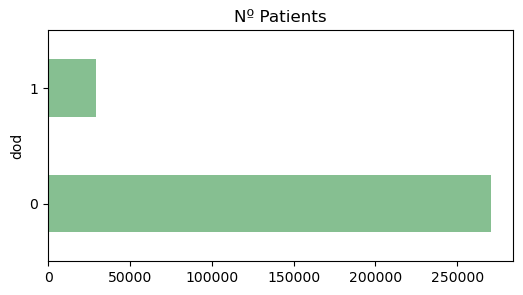

In [41]:
pat.dod.value_counts().plot.barh(title="Nº Patients", figsize=(6,3), color='#86bf91')
print("How many patient have died?")
print(pat.dod.value_counts()[1], "patients have died")

In [42]:
pat.dod.value_counts(normalize=True).mul(100).round(1).astype(str) + '%'

dod
0    90.3%
1     9.7%
Name: proportion, dtype: object

In [43]:
print("The people who dies is much older (av=71.5 y.o.) compared to the general hospital population (48.5 y.o.) (T-test=211.2, p-value=0.0).") 

The people who dies is much older (av=71.5 y.o.) compared to the general hospital population (48.5 y.o.) (T-test=211.2, p-value=0.0).


In [44]:
pat.groupby('dod')['anchor_age'].describe()

,count,mean,std,min,25%,50%,75%,max
dod,,,,,,,,
0,270636.0,46.074635,19.899586,18.0,28.0,44.0,61.0,91.0
1,29076.0,71.486174,15.223573,18.0,62.0,74.0,84.0,91.0


In [45]:
pat['anchor_age'].describe().to_frame().T

,count,mean,std,min,25%,50%,75%,max
anchor_age,299712.0,48.539888,20.89565,18.0,29.0,48.0,65.0,91.0


In [46]:
from scipy.stats import ttest_ind
D = pat[pat['dod']==1]
A = pat[pat['dod']==0]
ttest_ind(D['anchor_age'], A['anchor_age'])

TtestResult(statistic=211.20900139937302, pvalue=0.0, df=299710.0)

In [ ]:
px.box(pat, x="dod", y="anchor_age",width=700, height=500)

##### Mortality / Age relation

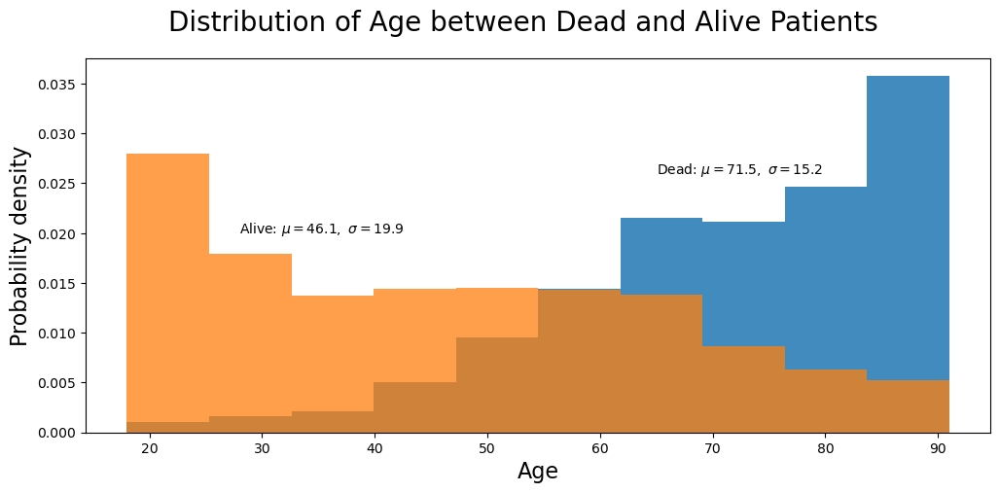

In [48]:
fig = plt.figure(figsize= (12, 5))
ax = fig.add_subplot(111)
age_dead = plt.hist(pat['anchor_age'][pat['dod'] == 1], label= "Dead", density= True, alpha=0.85)
age_alive = plt.hist(pat['anchor_age'][pat['dod'] == 0], label= "Alive", density= True, alpha=0.75)

plt.suptitle("Distribution of Age between Dead and Alive Patients", fontsize= 20)
plt.xlabel("Age", fontsize= 16)
plt.ylabel("Probability density", fontsize= 16)

plt.text(65, .026, f"Dead: $\mu= {pat['anchor_age'][pat['dod'] == 1].mean(): .1f}, \ \sigma= {pat['anchor_age'][pat['dod'] == 1].std(): .1f}$")
plt.text(28, .020, f"Alive: $\mu= {pat['anchor_age'][pat['dod'] == 0].mean(): .1f}, \ \sigma= {pat['anchor_age'][pat['dod'] == 0].std(): .1f}$")

plt.show()

In [49]:
print("Wwoman and men who have died average age is similar:")

pat.groupby(['gender','dod'])['anchor_age'].describe()

Wwoman and men who have died average age is similar:


count       mean        std   min   25%   50%   75%   max
gender dod                                                              
F      0    144674.0  45.641318  20.452359  18.0  27.0  43.0  61.0  91.0
       1     13879.0  73.605015  14.805548  19.0  64.0  77.0  86.0  91.0
M      0    125962.0  46.572323  19.233156  18.0  29.0  46.0  61.0  91.0
       1     15197.0  69.551096  15.342470  18.0  60.0  71.0  82.0  91.0

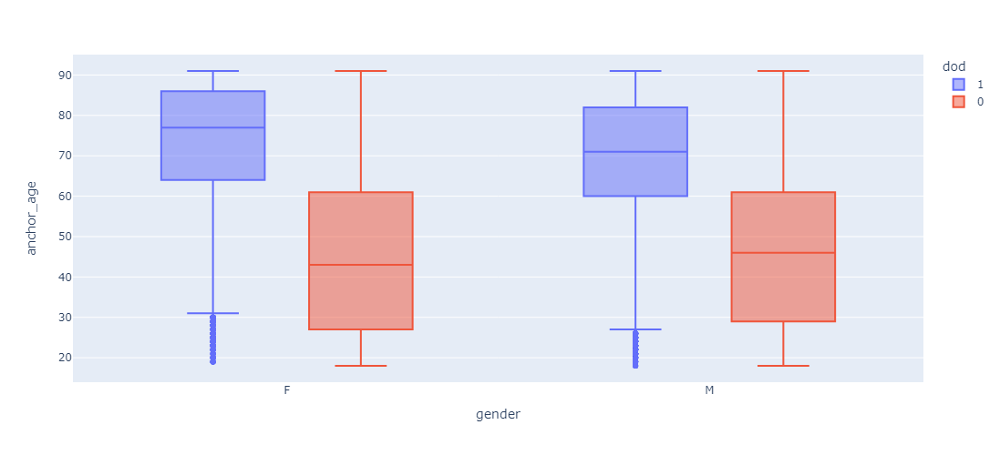

In [50]:
fig = px.box(pat, x="gender", y="anchor_age", color="dod", width=800, height=500)
fig.update_traces(quartilemethod="exclusive") # or "inclusive", or "linear" by default
fig.show()

##### Mortality/ Years Distribution

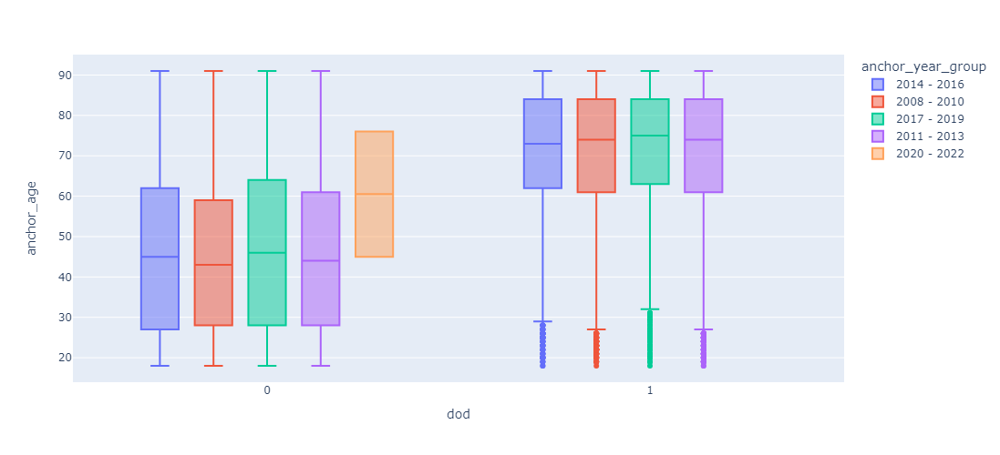

In [51]:
fig = px.box(pat, x="dod", y="anchor_age", color="anchor_year_group", width=800, height=500)
fig.update_traces(quartilemethod="exclusive") # or "inclusive", or "linear" by default
fig.update_xaxes(categoryorder='total ascending')
fig.show()

Text(0.5, 0, 'Dead / Alive ratio')

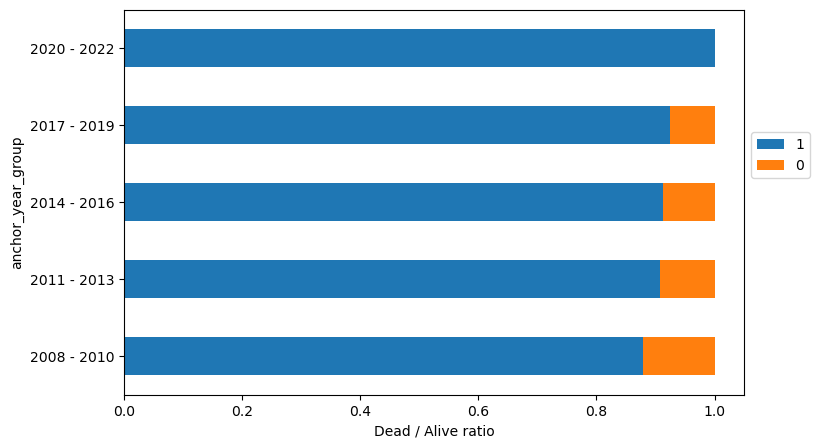

In [52]:
gd = pat.groupby(['anchor_year_group', 'dod']).size().unstack()
gd.apply(lambda x:x/x.sum(), axis=1).plot(kind='barh', stacked=True, legend=False, figsize=(8,5))
plt.legend(['1', '0'], bbox_to_anchor=(1.0, 0.7))
plt.xlabel('Dead / Alive ratio')